### Object Detection using DLTK

#### Introduction

>Object detection is a computer technology related to computer vision and image processing that deals with detecting instances of semantic objects of a certain class in digital images and videos.
    ~[wikipedia](https://en.wikipedia.org/wiki/Object_detection)


In this notebook, we will use DLTK to detect objects in sample Images from open source models & also AI engines like Azure.

Object Detection Model will return following information

- Bounding box: Where object is located in an image
- Object name: What is the name of the object corresponding to each detected object
- confidence: how confident model is while making those predictions

#### Import necessary packages

In [3]:
from PIL import Image

import sys
sys.path.append("../../")

from dltk_ai.visualization import draw_bbox
import json

In [ ]:
import dltk_ai

#### Read Image

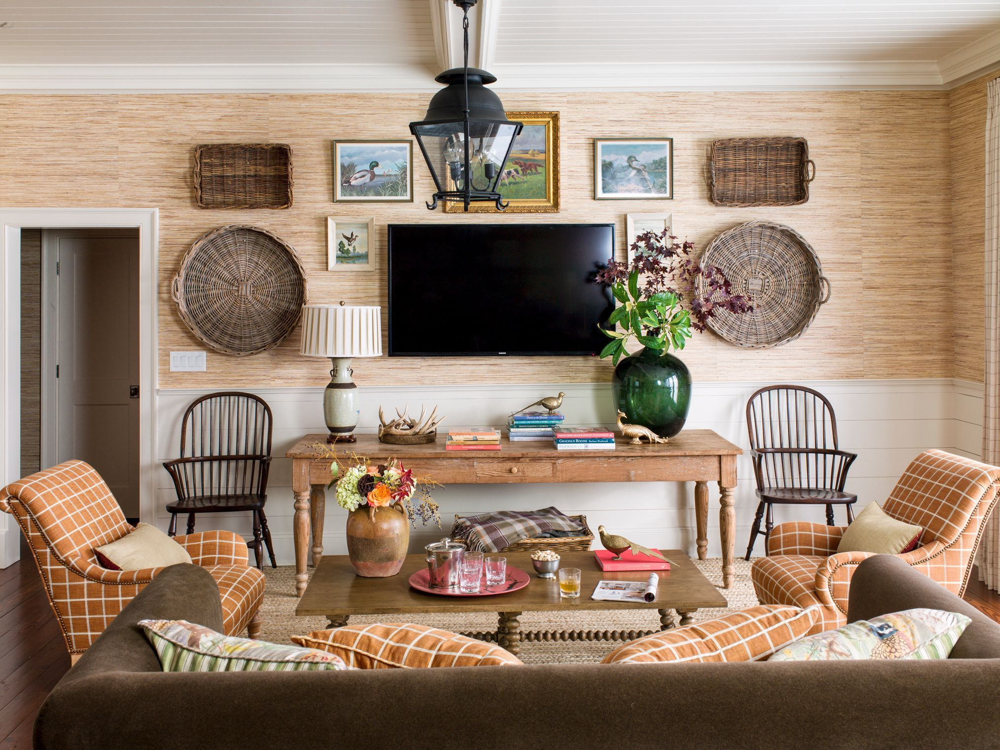

In [4]:
img_path = "./examples/data/image/object_detection_sample_2.jpg"
img = Image.open(img_path)
img

#### Use DLTK to detect object

#### Intialize DLTK client

> <u>Parameters Descriptions</u>
>
> **API key**: `If authentication is enabled`, you need to provide a valid API key
>
> **base_url**: url where kong/base service provided by OpenDLTK is deployed.

In [7]:
import dltk_ai
client = dltk_ai.DltkAiClient(base_url='http://localhost:8000')

<div class="alert alert-block alert-info">
<b>See Also:</b> 

 

1. [How to generate API key](https://docs.dltk.ai/qubitai-dltk/docs/build/html/getting_started/generateAPIkey.html)
2. [OpenDLTK deployment](http://docs.dltk.ai/qubitai-dltk/docs/build/html/getting_started/openDLTK_setup.html)

 

</div>

In [9]:
object_detection_response = client.object_detection(image_path= img_path, wait_time=15)
object_detection_response

It's taking too long than expected!! Use check_cv_job('a3428caa-2039-4a40-ae94-efde4edef6aa') to check status of your request


{'task_status': 'PENDING', 'task_id': 'a3428caa-2039-4a40-ae94-efde4edef6aa'}

<font color='green'>Note : If you get message as shown below then uncomment and run below cell</font>

> It's taking too long than expected!! Use check_cv_job('14866aa0-7135-42c1-ba91-e302113d72c4') to check status of your request




In [10]:
object_detection_response = client.check_cv_job(object_detection_response['task_id'])
object_detection_response

{'task_status': 'SUCCESS',
 'task_id': 'a3428caa-2039-4a40-ae94-efde4edef6aa',
 'output': {'tensorflow_detected_objects': [{'object_name': 'vase',
    'confidence': 0.6711814403533936,
    'bbox': {'x1': 702, 'y1': 1019, 'x2': 830, 'y2': 1172}},
   {'object_name': 'chair',
    'confidence': 0.6634005308151245,
    'bbox': {'x1': 1500, 'y1': 774, 'x2': 1748, 'y2': 1144}},
   {'object_name': 'chair',
    'confidence': 0.6156675219535828,
    'bbox': {'x1': 319, 'y1': 792, 'x2': 566, 'y2': 1156}},
   {'object_name': 'chair',
    'confidence': 0.5750893950462341,
    'bbox': {'x1': 6, 'y1': 929, 'x2': 489, 'y2': 1334}},
   {'object_name': 'vase',
    'confidence': 0.5276069641113281,
    'bbox': {'x1': 1240, 'y1': 710, 'x2': 1398, 'y2': 889}}]}}

#### Visualization of output

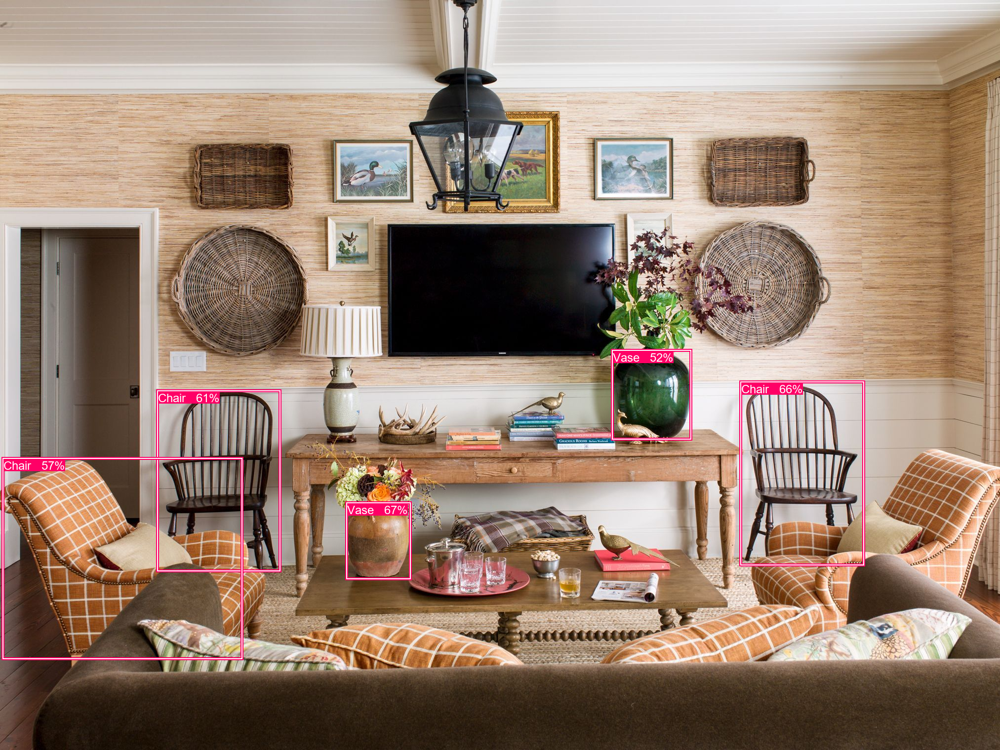

In [11]:
tensforflow_output = object_detection_response['output']['tensorflow_detected_objects']
bboxes = [object_['bbox'].values() for object_ in tensforflow_output]
captions = [f'{object_["object_name"] }   {int(object_["confidence"]*100)}%'  for object_ in tensforflow_output]

draw_bbox(img, bboxes, captions)

#### Using Third Party Object Detectors

<div class="alert alert-block alert-danger"> <b>Caution:</b> Run below cell, only if <b>Supported AI Engine Credentials</b> are updated in openDLTK configurations while installation </div>

In [15]:
object_detection_response = client.object_detection(image_path = img_path, object_detectors=['azure'])

object_detection_response

{'task_status': 'SUCCESS',
 'task_id': 'c981b1d7-71f1-4d6f-a104-3c67a5bd415f',
 'output': {'azure_detected_objects': [{'bbox': {'x1': 1249,
     'y1': 709,
     'x2': 1399,
     'y2': 890},
    'object_name': 'vase',
    'confidence': 0.657},
   {'bbox': {'x1': 1190, 'y1': 443, 'x2': 1450, 'y2': 854},
    'object_name': 'plant',
    'confidence': 0.776},
   {'bbox': {'x1': 327, 'y1': 820, 'x2': 556, 'y2': 1198},
    'object_name': 'chair',
    'confidence': 0.886},
   {'bbox': {'x1': 1486, 'y1': 771, 'x2': 1737, 'y2': 1162},
    'object_name': 'chair',
    'confidence': 0.843},
   {'bbox': {'x1': 40, 'y1': 948, 'x2': 428, 'y2': 1310},
    'object_name': 'chair',
    'confidence': 0.659},
   {'bbox': {'x1': 1685, 'y1': 910, 'x2': 2013, 'y2': 1260},
    'object_name': 'chair',
    'confidence': 0.74}]}}

<font color='green'>Note : If you get message as shown below then uncomment and run below cell</font>

> It's taking too long than expected!! Use check_cv_job('14866aa0-7135-42c1-ba91-e302113d72c4') to check status of your request




In [16]:
#object_detection_response = client.check_cv_job(object_detection_response['task_id'])
#object_detection_response

{'task_status': 'SUCCESS',
 'task_id': 'c981b1d7-71f1-4d6f-a104-3c67a5bd415f',
 'output': {'azure_detected_objects': [{'bbox': {'x1': 1249,
     'y1': 709,
     'x2': 1399,
     'y2': 890},
    'object_name': 'vase',
    'confidence': 0.657},
   {'bbox': {'x1': 1190, 'y1': 443, 'x2': 1450, 'y2': 854},
    'object_name': 'plant',
    'confidence': 0.776},
   {'bbox': {'x1': 327, 'y1': 820, 'x2': 556, 'y2': 1198},
    'object_name': 'chair',
    'confidence': 0.886},
   {'bbox': {'x1': 1486, 'y1': 771, 'x2': 1737, 'y2': 1162},
    'object_name': 'chair',
    'confidence': 0.843},
   {'bbox': {'x1': 40, 'y1': 948, 'x2': 428, 'y2': 1310},
    'object_name': 'chair',
    'confidence': 0.659},
   {'bbox': {'x1': 1685, 'y1': 910, 'x2': 2013, 'y2': 1260},
    'object_name': 'chair',
    'confidence': 0.74}]}}

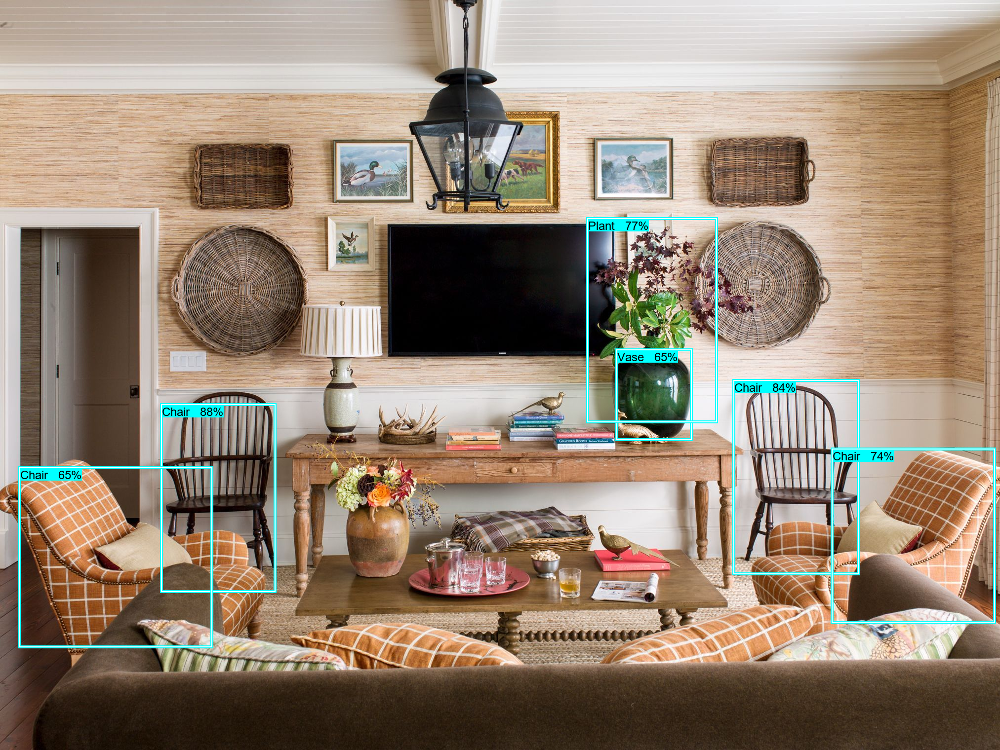

In [17]:
azure_output = object_detection_response['output']['azure_detected_objects']
bboxes = [object_['bbox'].values() for object_ in azure_output]
captions = [f'{object_["object_name"] }   {int(object_["confidence"]*100)}%' for object_ in azure_output]

draw_bbox(img, bboxes, captions, bbox_color=(0,255,255), font_color=(0,0,0))

### Comparing object Detectors

<div class="alert alert-block alert-danger"> <b>Caution:</b> Run below cell, only if <b>Supported AI Engine Credentials</b> are updated in openDLTK configurations while installation </div>

In [19]:
object_detection_response = client.object_detection(image_path = img_path, object_detectors = ['tensorflow','azure'])

object_detection_response

It's taking too long than expected!! Use check_cv_job('64d7e217-9637-40c7-a277-41c706ad314f') to check status of your request


{'task_status': 'SUCCESS',
 'task_id': '64d7e217-9637-40c7-a277-41c706ad314f',
 'output': {'azure_detected_objects': [{'bbox': {'x1': 1249,
     'y1': 709,
     'x2': 1399,
     'y2': 890},
    'object_name': 'vase',
    'confidence': 0.657},
   {'bbox': {'x1': 1190, 'y1': 443, 'x2': 1450, 'y2': 854},
    'object_name': 'plant',
    'confidence': 0.776},
   {'bbox': {'x1': 327, 'y1': 820, 'x2': 556, 'y2': 1198},
    'object_name': 'chair',
    'confidence': 0.886},
   {'bbox': {'x1': 1486, 'y1': 771, 'x2': 1737, 'y2': 1162},
    'object_name': 'chair',
    'confidence': 0.843},
   {'bbox': {'x1': 40, 'y1': 948, 'x2': 428, 'y2': 1310},
    'object_name': 'chair',
    'confidence': 0.659},
   {'bbox': {'x1': 1685, 'y1': 910, 'x2': 2013, 'y2': 1260},
    'object_name': 'chair',
    'confidence': 0.74}],
  'tensorflow_detected_objects': [{'object_name': 'vase',
    'confidence': 0.6711814403533936,
    'bbox': {'x1': 702, 'y1': 1019, 'x2': 830, 'y2': 1172}},
   {'object_name': 'chair',
   

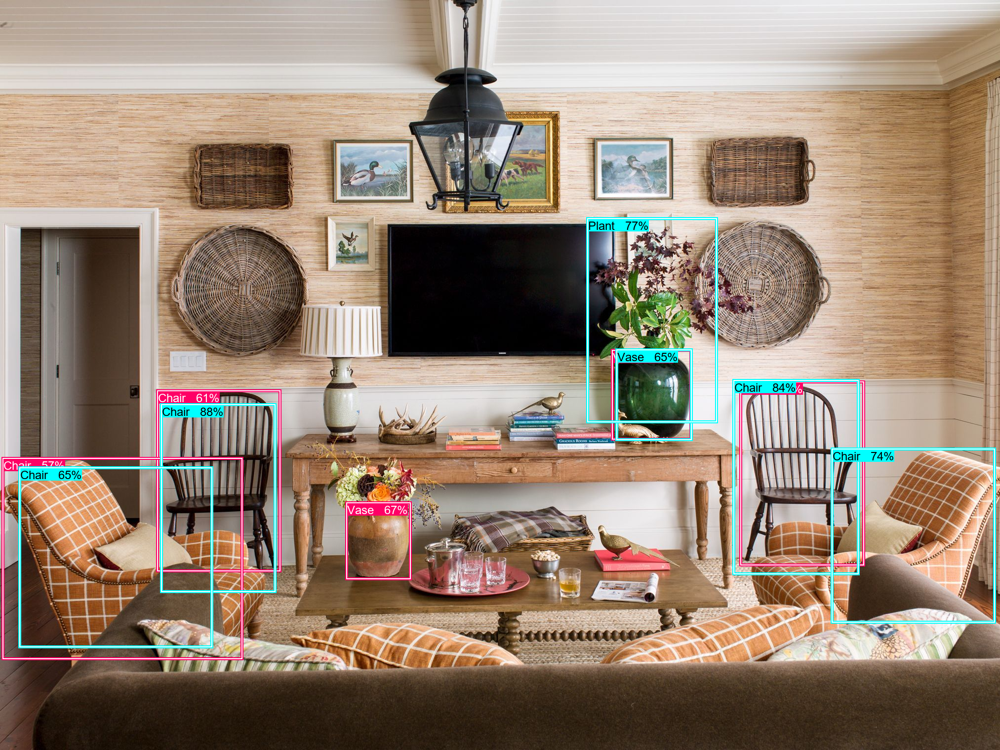

In [22]:
tensforflow_output = object_detection_response['output']['tensorflow_detected_objects']
tf_bboxes = [list(object_['bbox'].values()) for object_ in tensforflow_output]
tf_captions = [f'{object_["object_name"] }   {int(object_["confidence"]*100)}%' for object_ in tensforflow_output]
tf_scores = [object_['confidence'] for object_ in tensforflow_output]

tf_output_image = draw_bbox(img, tf_bboxes, tf_captions)

azure_output = object_detection_response['output']['azure_detected_objects']
azure_bboxes = [list(object_['bbox'].values()) for object_ in azure_output]
azure_captions = [f'{object_["object_name"] }   {int(object_["confidence"]*100)}%' for object_ in azure_output]
azure_scores = [object_['confidence'] for object_ in azure_output]

draw_bbox(tf_output_image, azure_bboxes, azure_captions, bbox_color=(0,255,255), font_color=(0,0,0))



## References:

For more detail on using object detection API please refer [DLTK object Detection Documentation](https://docs.dltk.ai/computer_vision/index.html#object-detection)

:
<center><b>For More Details about DLTK</b></center>

|[<img src="https://pbs.twimg.com/profile_images/909757546063323137/-RIWgodF.jpg" width=50 title="Pypi Logo"/>](https://pypi.org/project/qubitai-dltk/) |[<img src="https://cdn.iconscout.com/icon/free/png-512/documentation-1502741-1272951.png" width=50 title="Documentation"/>](https://docs.dltk.ai) | [<img src="https://cdn4.iconfinder.com/data/icons/iconsimple-logotypes/512/github-512.png" width=50 title="Documentation"/>](https://docs.dltk.ai)| 
|:-------------:|:-------:|:--------:|
|pypi|Documentation|Github|